In [2]:
import pandas as pd 
import ipywidgets as widgets
from ipywidgets import interact, interact_manual

In [3]:
#importing the data 
df_actual = pd.read_csv('UTMSBA_ACTL.csv')
df_schd = pd.read_csv('UTMSBA_SCHD.csv')

In [4]:
df1 = df_actual.copy()
df2 = df_schd.copy()

# EDA

In [5]:
df1

,Dep_dt,Orig,Dest,Tail,Stage_length,ACTL_TM_IN_CENT,ACTL_TM_OUT_CENT,ACFT,Actl_BM,Gross_gal,Enroute_gal,Alt_gal,Cont_gal,Tanker_gal
0,2017-09-01,FYX,ZEY,N09303,240,1005,844,73W,81,536.3,265,0.0,271.4,0.0
1,2017-09-01,ZEY,KMU,N09303,274,1139,1043,73W,56,1145.6,495,378.2,272.4,0.0
2,2017-09-01,KMU,DWF,N09303,1419,1520,1221,73W,179,1923.3,1695,0.0,228.3,0.0
3,2017-09-01,DWF,ZEY,N09303,1213,1838,1556,73W,162,2115.7,1883,0.0,233.1,0.0
4,2017-09-01,ZEY,FSG,N09303,1051,2140,1925,73W,135,2703.5,1432,0.0,241.4,1029.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3257616,2020-01-22,ZEY,PEB,N92669,411,1115,955,73W,80,2315.5,674,531.2,177.1,933.6
3257617,2020-01-22,PEB,NQJ,N92669,328,1309,1204,73W,65,0.0,0,0.0,0.0,0.0
3257618,2020-01-22,NQJ,ZEY,N92669,251,1522,1408,73W,74,0.0,0,0.0,0.0,0.0
3257619,2020-01-22,ZEY,AIJ,N92669,1136,2018,1750,73W,148,2903.7,1847,800.8,256.2,0.0


In [6]:
for i in df1.columns[1:4]:
    print(i,len(df1[i].value_counts()))

Orig 151
Dest 150
Tail 754


In [7]:
df1['pairs'] = df1['Orig'] + ' - ' + df1['Dest']
df1['pairs'].value_counts()[:20].plot(kind = 'bar', figsize = (10,10), color = ['green','red','blue'])

In [8]:
import plotly.express as px
df_sample = df1.sample(100000)
df_sample = df_sample[df_sample['Gross_gal'] < 8000]
fig = px.scatter(x=df_sample['Stage_length'], y=df_sample['Gross_gal'])
fig.show()

In [9]:
import plotly.express as px
df_sample = df1.sample(100000)
df_sample = df_sample[df_sample['Enroute_gal'] < 10000]
fig = px.scatter(x=df_sample['Stage_length'], y=df_sample['Enroute_gal'])
fig.show()

In [10]:
import plotly.express as px
df_sample = df1.sample(100000)
#df_sample = df_sample[df_sample['Cont_gal'] < 10000]
fig = px.scatter(x=df_sample['Stage_length'], y=df_sample['Cont_gal'])
fig.show()

In [11]:
import plotly.express as px
df_sample = df1.sample(100000)
#df_sample = df_sample[df_sample['Cont_gal'] < 10000]
fig = px.scatter(x=df_sample['Stage_length'], y=df_sample['Tanker_gal'])
fig.show()

/opt/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:203: UserWarning:

'colors' is being deprecated. Please use 'color'instead of 'colors'



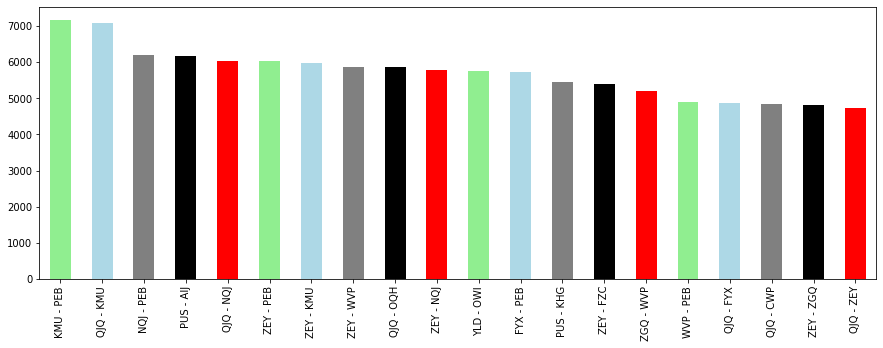

In [15]:
df1[df1['Tanker_gal'] > 0]['pairs'].value_counts().head(20).plot(kind = 'bar', colors = ['lightgreen','lightblue','grey','black','red'], figsize = (15,5))

In [16]:
df1['ACFT'].value_counts()

73W    2474416
73H     742611
7M8      40594
Name: ACFT, dtype: int64

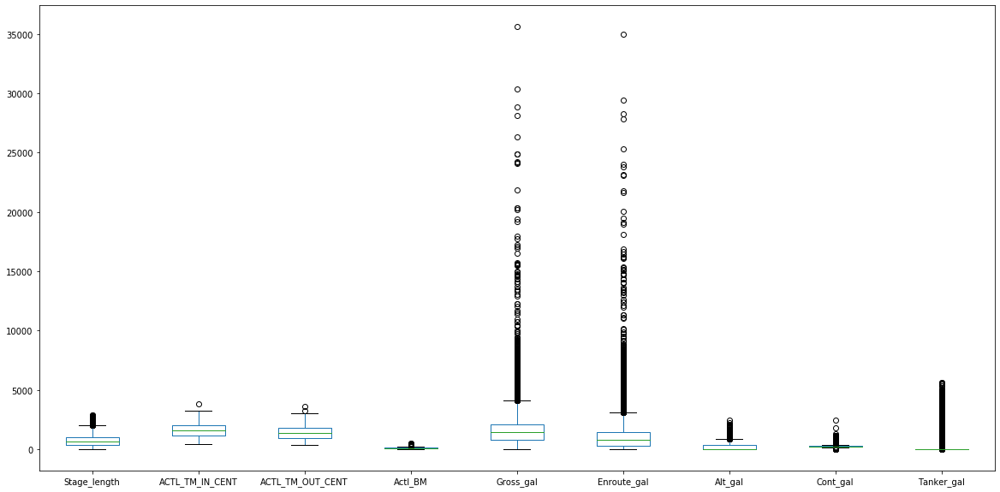

In [17]:
ax = df1.plot.box(['ACFT','Gross_gal'], figsize = (20,10))

In [18]:
import datetime

def date_format(value):
    year = int(value[:4])
    month = int(value[5:7])
    day = int(value[8:])
    
    #print(year,month,day)
    date = datetime.date(year,month, day)
    return date 


df1['Dep_dt'] = df1['Dep_dt'].map(date_format)
#df1.plot(df1['Dep_dt'], df1['Gross_gal'])


/opt/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:203: UserWarning:

'colors' is being deprecated. Please use 'color'instead of 'colors'



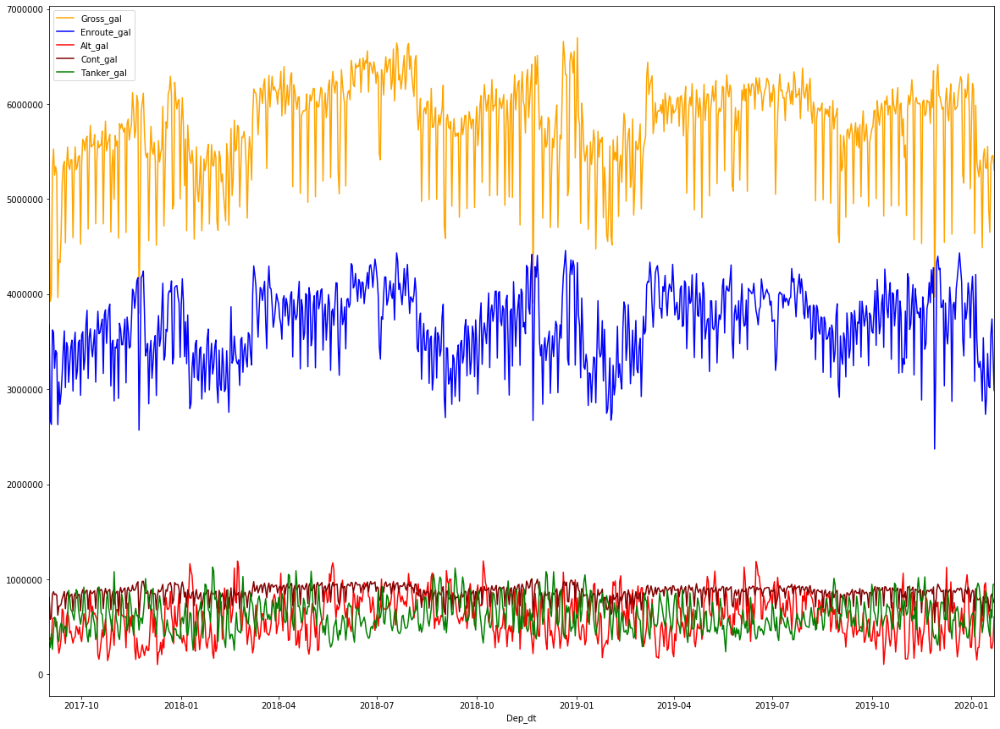

In [19]:
df1.groupby('Dep_dt').sum().plot(y = ['Gross_gal','Enroute_gal','Alt_gal','Cont_gal','Tanker_gal'], figsize = (20,15), colors = ['orange','blue','red','maroon','green'])



In [20]:
a_list = df1['pairs'].value_counts().index[:51]
def top_stations(value): 
    if value in a_list: 
        return 1 
    return 0 

df1['top_50'] = df1['pairs'].map(top_stations)
top_sta = df1[df1['top_50'] == 1]

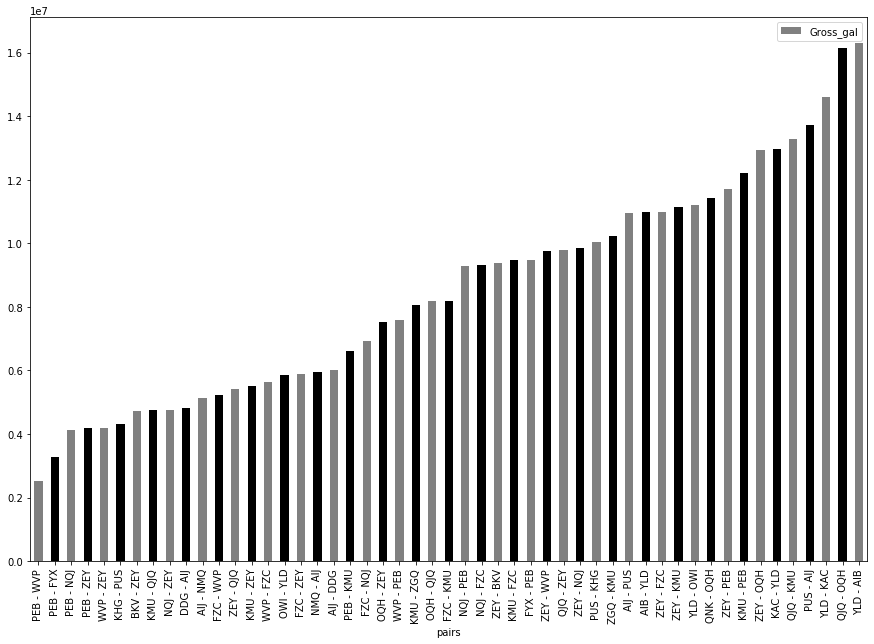

In [21]:
top_sta.groupby('pairs').sum().sort_values(by = 'Gross_gal').plot(kind = 'bar',y = 'Gross_gal', figsize = (15,10), colors = ['grey','black'])



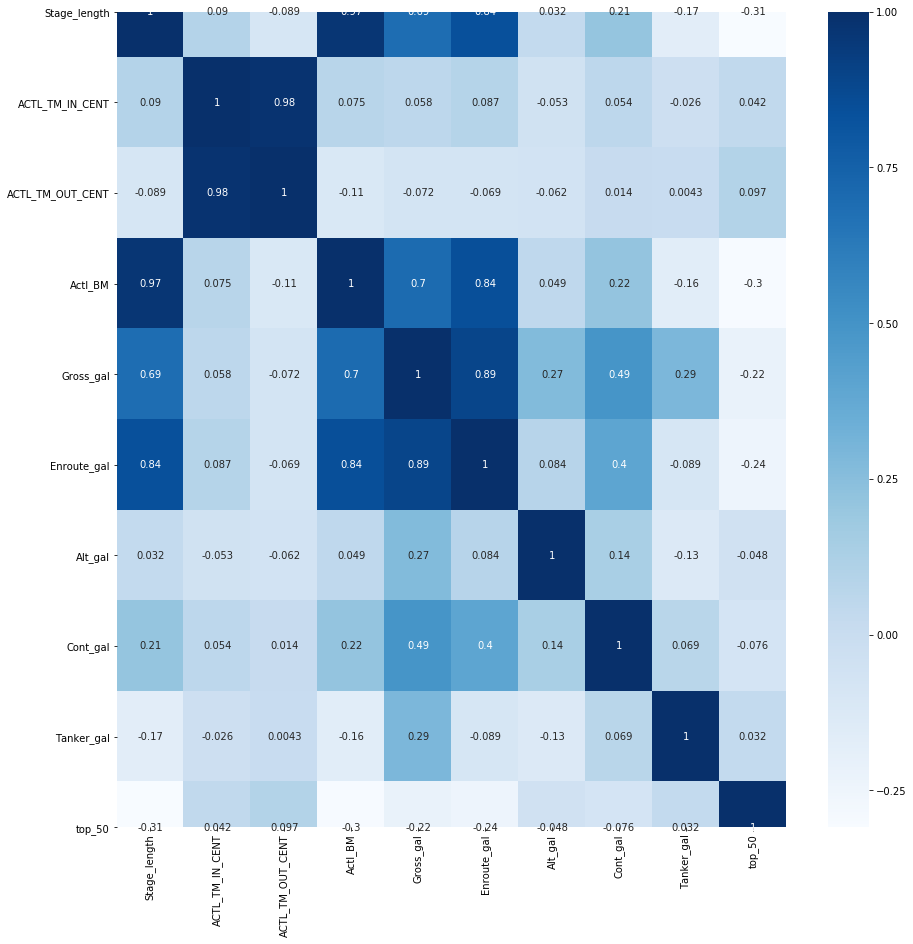

In [22]:


import seaborn as sns
import matplotlib.pyplot as plt
corr = df1.corr()

# plot the heatmap
fig, ax = plt.subplots(figsize=(15,15)) 
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns,cmap = "Blues", annot = True)

In [23]:
def hour_of_the_day(time):
    time = str(time)
    return int(time[:-2])

df1['hour_out'] = df1['ACTL_TM_OUT_CENT'].map(hour_of_the_day)
df1['hour_in'] = df1['ACTL_TM_IN_CENT'].map(hour_of_the_day)

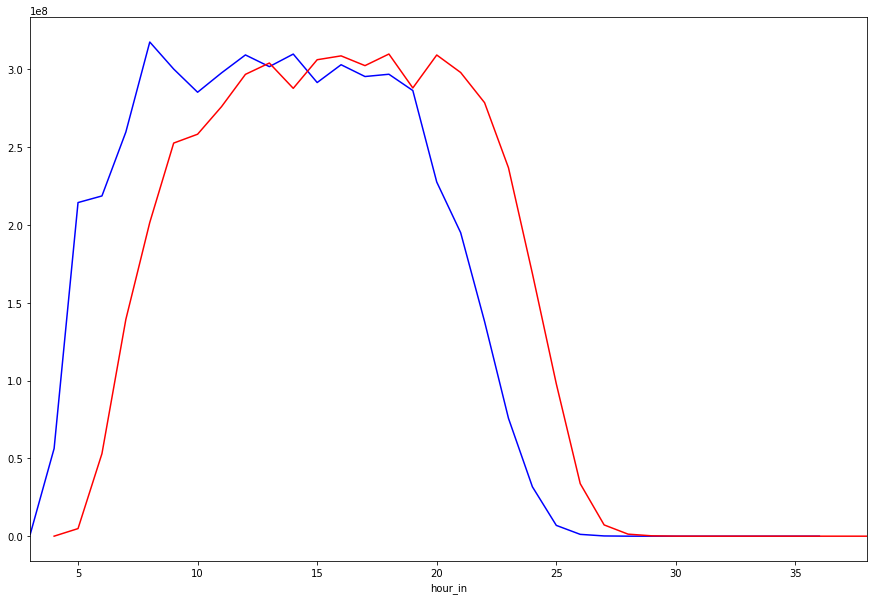

In [24]:
fig, ax = plt.subplots(figsize=(15,10)) 
df1.groupby('hour_out').sum()['Gross_gal'].plot(color = ['blue'])
df1.groupby('hour_in').sum()['Gross_gal'].plot(color = ['r'])

In [ ]:
print('There are',len(df1['Tail'].value_counts()),'tail numbers present in the dataset.')

# Feature Engineering

In [27]:
df1.head()

,Dep_dt,Orig,Dest,Tail,Stage_length,ACTL_TM_IN_CENT,ACTL_TM_OUT_CENT,ACFT,Actl_BM,Gross_gal,Enroute_gal,Alt_gal,Cont_gal,Tanker_gal,pairs,top_50,hour_out,hour_in
0,2017-09-01,FYX,ZEY,N09303,240,1005,844,73W,81,536.3,265,0.0,271.4,0.0,FYX - ZEY,0,8,10
1,2017-09-01,ZEY,KMU,N09303,274,1139,1043,73W,56,1145.6,495,378.2,272.4,0.0,ZEY - KMU,1,10,11
2,2017-09-01,KMU,DWF,N09303,1419,1520,1221,73W,179,1923.3,1695,0.0,228.3,0.0,KMU - DWF,0,12,15
3,2017-09-01,DWF,ZEY,N09303,1213,1838,1556,73W,162,2115.7,1883,0.0,233.1,0.0,DWF - ZEY,0,15,18
4,2017-09-01,ZEY,FSG,N09303,1051,2140,1925,73W,135,2703.5,1432,0.0,241.4,1029.7,ZEY - FSG,0,19,21


In [43]:
df1.pivot_table(index = ['pairs','Orig'])

,,ACTL_TM_IN_CENT,ACTL_TM_OUT_CENT,Actl_BM,Alt_gal,Cont_gal,Enroute_gal,Gross_gal,Stage_length,Tanker_gal,hour_in,hour_out,top_50
pairs,Orig,,,,,,,,,,,,
AIB - AIJ,AIB,1531.449454,1264.254451,160.750431,158.157180,253.008616,1486.177484,1917.626795,1035,20.273291,15.023837,12.362723,0
AIB - AQL,AIB,1587.822907,1383.888106,122.102203,189.035683,244.856035,985.821145,1695.194890,727,275.486167,15.591189,13.545374,0
AIB - AUT,AIB,1595.283470,1337.893101,154.016052,140.455806,227.937568,1374.255806,1855.058607,1142,112.398258,15.663251,13.078893,0
AIB - BSI,AIB,1571.521031,1313.030529,155.261194,187.604071,227.375373,1508.970828,1962.685278,1142,38.737381,15.421303,12.840570,0
AIB - BUX,AIB,1895.000000,1509.145833,230.020833,281.445833,272.800000,2322.166667,2913.077083,1652,36.697917,18.645833,14.750000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZXU - YGX,ZXU,1267.500000,1142.500000,65.000000,325.000000,261.450000,1810.500000,2396.800000,25,0.000000,12.500000,11.000000,0
ZXU - YLD,ZXU,1812.200000,1666.200000,82.000000,173.700000,186.280000,833.200000,1577.140000,31,383.940000,18.000000,16.400000,0
ZXU - ZJJ,ZXU,1296.333333,1043.333333,146.333333,525.133333,169.733333,1012.000000,1738.633333,472,31.633333,12.666667,10.000000,0
